In [21]:
import pandas as pd
import seaborn as sns 
import plotly.express as px
import numpy as np

In [23]:
final_dataset=pd.read_csv('data/final_26_09.csv',  keep_default_na=False, na_values=['','NaN'])
final_dataset.groupby('source')['seats'].sum()

source
ANAC           1.327241e+08
AUS Stats      6.901635e+07
BTS            1.294966e+09
Estimation     1.657894e+09
Eurocontrol    1.345648e+09
OpenSky        2.072459e+08
WorldBank      8.627702e+08
Name: seats, dtype: float64

## Final evaluation of the dataset

### IEA DATA

The internaitional energy agency provides a database listing all the energy consumption flows (World Energy Statitics).
It was purchased in order to evaluate the quality of the estimated dataset. 
However, a full open-source option exists on https://data.un.org/ , with the same data.

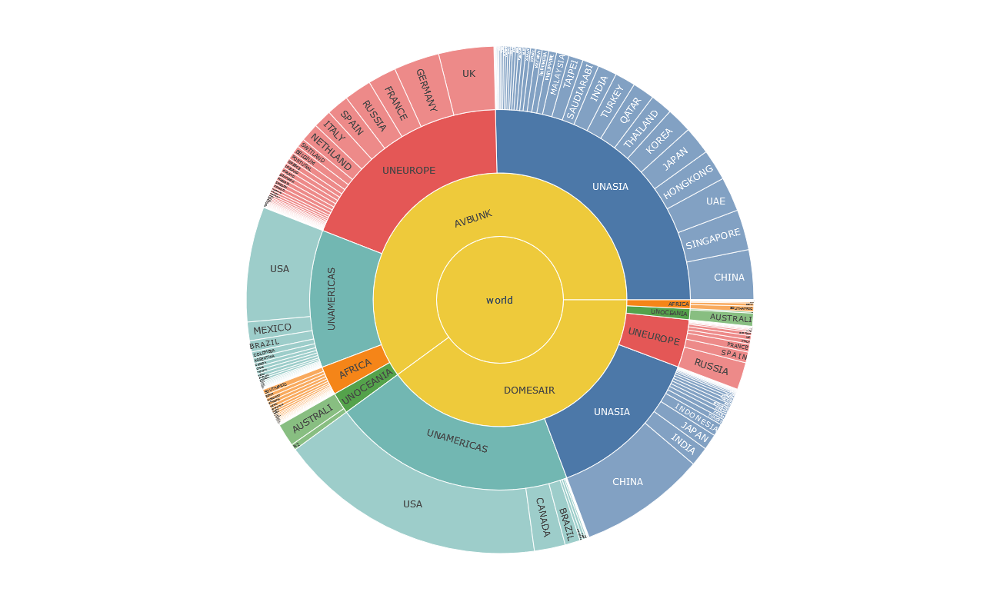

*Figure obtained with IEA aviation fuel data*


In [3]:
#loading and processing iea data 

iea_2019=pd.read_csv('data/iea_processed_2019.csv')
country_code=pd.read_csv('data/country_codes.csv', keep_default_na=False)
iea_2019=iea_2019.merge(country_code[['Three_Letter_Country_Code','Two_Letter_Country_Code']].dropna(), left_on='ISO3', right_on='Three_Letter_Country_Code', how='left')

# 04 - Evaluating the final dataset

Author: **A. Salgas** (antoine.salgas@isae-supaero.fr)

This notebook is the direct continuation of (03_routes_schedule/03_routes_product.ipynb)

In this notebook, the aggregated dataset is compared to various references.


In [4]:
final_dataset['arrival_continent']=final_dataset.apply(lambda row: 'EU' if row['arrival_country']=='TR' else row['arrival_continent'], axis=1)
final_dataset['departure_continent']=final_dataset.apply(lambda row: 'EU' if row['departure_country']=='TR' else  row['departure_continent'], axis=1)
final_dataset_TEST=final_dataset.copy()

In [5]:
grouped_fuel=final_dataset_TEST.groupby(['departure_country'])['fuel_burn'].sum().reset_index()

In [6]:
grouped_fuel=grouped_fuel.merge(iea_2019[['Two_Letter_Country_Code','volume_numeric']].groupby(['Two_Letter_Country_Code'])['volume_numeric'].sum().reset_index(), left_on=['departure_country'], right_on=['Two_Letter_Country_Code'], how='inner')

In [7]:
grouped_fuel['fuel_burn']=grouped_fuel['fuel_burn']/1000000


In [8]:
grouped_fuel['coverage_iea']=grouped_fuel['fuel_burn']/grouped_fuel['volume_numeric']*100

In [9]:
grouped_fuel['fuel_burn'].sum()/grouped_fuel['volume_numeric'].sum()*100

81.25977177312859

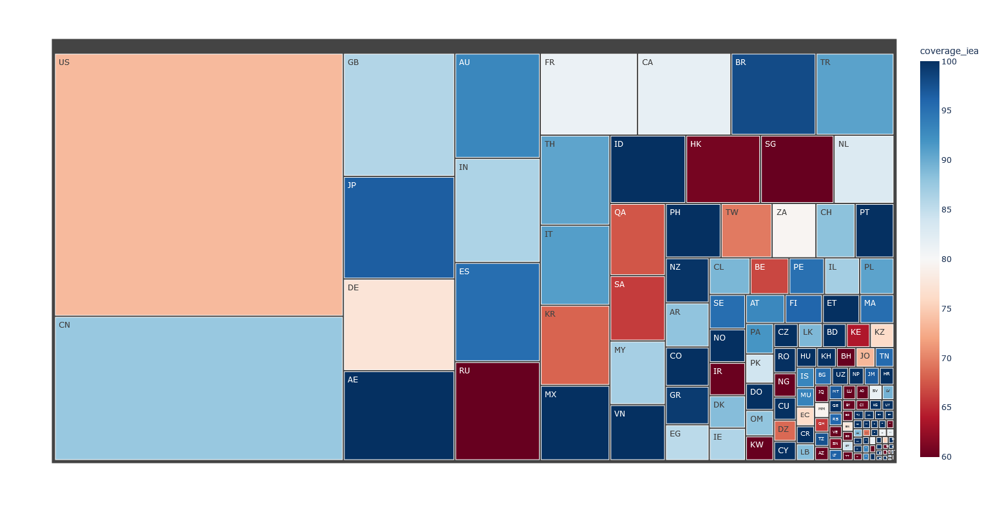

In [10]:
px.treemap(grouped_fuel, 
           path=['departure_country'], 
           values='fuel_burn',
           color='coverage_iea',
           color_continuous_scale='RdBu',
           range_color=[60,100],
          height=800,width=1200)

### OAG data

OAG is a commercial data provider, providing detailled flight shcedules. It is therfore a good way to evaluate the accuracy of the global dataset, let alone that their data is correct enough. Although this work focuses on 2019 flights, 2018 OAG data, purchased for another project was used. Indeed, investing in 2019 data would have been to expensive for the benefits associated.  
To convert 2018 OAG data in "2019" data, the global RPK growth rate was applied to traffic figures. This is a rough method as some routes were created and discountinuated during the meantme, and that the growth rate is not uniform acroos the world. It could result in "2019" OAG data to be overestimated in developped countries and underestimated in developping countries.  
These limitations are to be kept in mind when evaluating the quality of the open-source dataset of this work. 

#### Airport by airport evaluation

*OAG DATA?* ==> Non-functionnal notebook, only output.

In [11]:
## 2018 OAG data was preprocessed in a separate notebook to match the format of the dataset of this work. Final steps are performed below.

oag=pd.read_csv('data/grouped_oag.csv', keep_default_na=False, na_values=['','NaN']).dropna()
#ICAO code of railways/other are not in airport database and country column will be na

oag.replace('IST','ISL', inplace=True)
oag.replace('SXF','BER', inplace=True)
oag.replace('EAP','MLH', inplace=True)
oag.replace('BSL','MLH', inplace=True)
oag.replace('TSE','NQZ', inplace=True)

oag['ISO_continent_arr']=oag.apply(lambda row: 'EU' if row['ISO_country_arr']=='TR' else row['ISO_continent_arr'], axis=1)
oag['ISO_continent_dep']=oag.apply(lambda row: 'EU' if row['ISO_country_dep']=='TR' else  row['ISO_continent_dep'], axis=1)

In [12]:
# 2018 to 2019 ==> Applying a 3% GR
oag['TotalSeatCapacity']=oag['TotalSeatCapacity']*1.034

In [13]:
oag['ask']=oag['Km']*oag['TotalSeatCapacity']

In [14]:
# create new column with sorted tuples of values in col1 and col2
oag['group_col'] = oag[['DepAirport', 'ArrAirport']].apply(lambda x: tuple(sorted(x)), axis=1)

# group by the new column
oag_grouped = oag.groupby(['group_col'])[['TotalSeatCapacity','ask']].sum().reset_index().rename(columns={'ask':'TotalAsk'})

### Individual route evaluation

In [15]:
# Creating a copy of the open-source dataset
final_dataset_TEST=final_dataset.copy()
final_dataset_TEST['group_col'] = final_dataset_TEST[['iata_departure', 'iata_arrival']].apply(lambda x: tuple(sorted(x)), axis=1)
est_grouped=final_dataset_TEST.groupby(['group_col', 'source'])[['seats','ask']].sum().reset_index()
est_grouped=est_grouped.groupby(['group_col']).agg({'source': lambda x: '-'.join(x), 'seats': 'sum', 'ask': 'sum'}).reset_index()

# Merging with OAG "reference"
est_df_oag=est_grouped.merge(oag_grouped, on='group_col', how='outer')


In [16]:
est_grouped

,group_col,source,seats,ask
0,"(05A, AET)",BTS,9.000000,0.000000e+00
1,"(05A, AKP)",BTS,18.000000,0.000000e+00
2,"(05A, ARC)",BTS,9.000000,0.000000e+00
3,"(05A, CXF)",BTS,18.000000,0.000000e+00
4,"(05A, FAI)",BTS,216.000000,0.000000e+00
...,...,...,...,...
59370,"(ZPB, ZSJ)",Estimation,40.369205,4.823779e+03
59371,"(ZRH, ZRH)",Eurocontrol,6845.329513,0.000000e+00
59372,"(ZRH, ZTH)",Eurocontrol,16938.375000,2.499250e+07
59373,"(ZUH, ZYI)",Estimation,84868.171057,7.578550e+07


Total seat capacity evaluation: each route is plotted with OAG capacity as a y-coordinate and the open-Source dataset as the x-coordinate.

R2 score: 0.7418719673316834


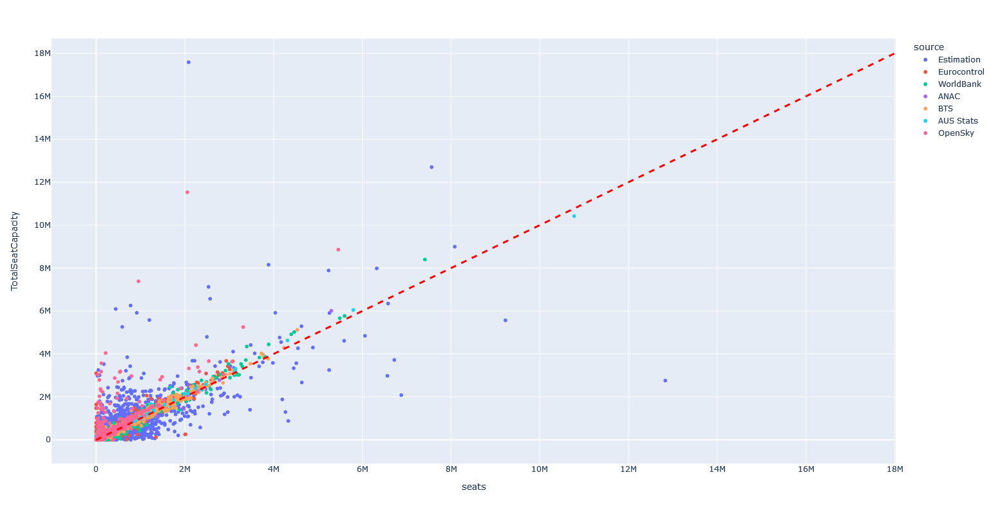

In [19]:
from sklearn.metrics import r2_score

est_df_oag_plot=est_df_oag.dropna()

print('R2 score: {}'.format(r2_score(est_df_oag_plot['TotalSeatCapacity'], est_df_oag_plot['seats'])))

fig=px.scatter(est_df_oag_plot, x='seats', y='TotalSeatCapacity', color='source', custom_data=['group_col'], width=800, height=800)

fig.update_traces(
    hovertemplate="<br>".join([
        "This work: %{x}",
        "OAG: %{y}",
        "Route: %{customdata[0]}",
    ])
)


fig.add_shape(
    type="line",
    x0=0,
    x1=18e6,
    y0=0,
    y1=18e6,
    line=dict(color="red", width=3, dash="dash"),
)
# fig.add_trace(line_trace)
fig

A few comments on the previous figure:
 - The eestimation dataset, is as expected very dispered, but apparently unbiased 
 - Eurocontrol data is satistactory, but this is also linked to the prelimininary restriction of the data if inconsistant with world bank data on the same route
 - World bank df is very highly correlated, suggesting that they could have sourced their data at OAG
 - ANAC data is highly correlated
 - BTS data is very highly correlated
 - Australian government data as well
 - Opensky data is however a bit disapointing, despite the numerous restriction there is a high underestimation in the capacity offred on most routes covered. 
 
 


R2 score: 0.9061705716710978


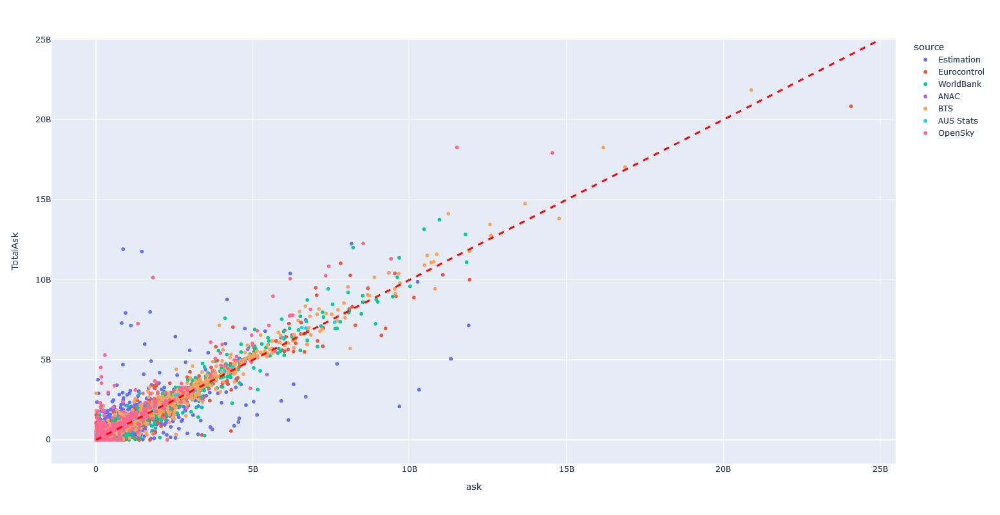

In [20]:
from sklearn.metrics import r2_score

print('R2 score: {}'.format(r2_score(est_df_oag_plot['TotalAsk'],est_df_oag_plot['ask'])))

fig=px.scatter(est_df_oag_plot, x='ask', y='TotalAsk', color='source', custom_data=['group_col'], width=800, height=800)

fig.update_traces(
    hovertemplate="<br>".join([
        "This work: %{x}",
        "OAG: %{y}",
        "Route: %{customdata[0]}",
    ])
)


fig.add_shape(
    type="line",
    x0=0,
    x1=25e9,
    y0=0,
    y1=25e9,
    line=dict(color="red", width=3, dash="dash"),
)

# fig.add_trace(line_trace)
fig

Switching from seats to ASK improves the R squared. Long flights seems to be more accurately accounted for than short flights.

In [19]:
est_df_oag.sum()

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_5956\2581859382.py:1: FutureWarning:

The default value of numeric_only in DataFrame.sum is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



group_col            (05A, AET, 05A, AKP, 05A, ARC, 05A, CXF, 05A, ...
seats                                                5570264647.798285
ask                                              10664323600399.433594
TotalSeatCapacity                                    5799237643.496001
TotalAsk                                         10491883620087.384766
dtype: object

In [20]:
(final_dataset_TEST['seats'].sum()-oag_grouped['TotalSeatCapacity'].sum())/oag_grouped['TotalSeatCapacity'].sum()*100

-3.9483292421119045

We have 95.3\% of OAG seats with our estimated dataset, and 101.6% of the ASK. 

In [21]:
(final_dataset_TEST['ask'].sum()-oag_grouped['TotalAsk'].sum())/oag_grouped['TotalAsk'].sum()*100

1.643555976754273

In [22]:
final_dataset_TEST.ask.sum()/1e9

10664.323600399435

This is very close to IATA figure of 5.504 B seats available under a 82.5\% load factor (https://www.iata.org/en/iata-repository/publications/economic-reports/airline-industry-economic-performance---november-2020---data-tables/)

### Airport evaluation

As already explained, the route per route accuracy is not the main target of this work. Airport/country and regional flow levels are explored next, as this is more consistent with the expected results. 

In [23]:
# The piece of code below is not very explicit, but to compute each airport traffic figures, 
# the arrivals/departure of each airport are separated into two dataframes, and concatenated together to count the total traffic.
# This is done for both OAG and our dataset. 

### This work 
est_seats_dep=final_dataset_TEST.groupby(['iata_departure','departure_lon','departure_lat'])[['seats','ask']].sum()
est_seats_arr=final_dataset_TEST.groupby(['iata_arrival','arrival_lon','arrival_lat'])[['seats']].sum()
est_seats_df=est_seats_arr.reset_index().merge(est_seats_dep.reset_index(),left_on='iata_arrival', right_on='iata_departure', how='outer')
est_seats_df['IATA']=est_seats_df['iata_arrival'].fillna(est_seats_df['iata_departure'])
est_seats_df['lon']=est_seats_df['arrival_lon'].fillna(est_seats_df['departure_lon'])
est_seats_df['lat']=est_seats_df['arrival_lat'].fillna(est_seats_df['departure_lat'])
est_seats_df['seats_tot']=est_seats_df['seats_x'].fillna(0)+est_seats_df['seats_y'].fillna(0)
est_seats_df['ask_tot']=est_seats_df['ask'].fillna(0)

est_seats_df.drop(columns={'iata_departure','iata_arrival','seats_x','seats_y','ask', 'arrival_lon','arrival_lat','departure_lon','departure_lat'}, inplace=True)
est_seats_df.set_index('IATA', inplace=True)

est_seats_df

### OAG 2018
oag_seats_dep=oag.groupby('DepAirport')[['TotalSeatCapacity','ask']].sum()
oag_seats_arr=oag.groupby('ArrAirport')[['TotalSeatCapacity']].sum()
oag_seats_df=oag_seats_arr.reset_index().merge(oag_seats_dep.reset_index(),left_on='ArrAirport', right_on='DepAirport', how='outer')
oag_seats_df['IATA']=oag_seats_df['ArrAirport'].fillna(oag_seats_df['DepAirport'])
oag_seats_df['seats_tot']=oag_seats_df['TotalSeatCapacity_x'].fillna(0)+oag_seats_df['TotalSeatCapacity_y'].fillna(0)
oag_seats_df['ask_tot']=oag_seats_df['ask'].fillna(0)
oag_seats_df.drop(columns={'DepAirport','ArrAirport','TotalSeatCapacity_x','TotalSeatCapacity_y','ask'}, inplace=True)
oag_seats_df.set_index('IATA', inplace=True)

airport_df=est_seats_df.merge(oag_seats_df, left_index=True, right_index=True, how='outer', suffixes=('_est','_oag'))

A few airports are referenced in only one of the dataset but the ask and seats capacities associated are below 1% of the dataset. 

In [24]:
print('Airport in OAG but not in estimation: Npax= {:.2f} M'.format(airport_df[airport_df['seats_tot_est'].isna()]['seats_tot_oag'].sum()/1000000))
print('Airport in Estimation but not in OAG: Npax= {:.2f} M'.format(airport_df[airport_df['seats_tot_oag'].isna()]['seats_tot_est'].sum()/1000000))

print('Airport in OAG but not in estimation: Ask= {:.2f} B'.format(airport_df[airport_df['ask_tot_est'].isna()]['ask_tot_oag'].sum()/1000000000))
print('Airport in Estimation but not in OAG: Ask= {:.2f} B'.format(airport_df[airport_df['ask_tot_oag'].isna()]['ask_tot_est'].sum()/1000000000))

Airport in OAG but not in estimation: Npax= 36.48 M
Airport in Estimation but not in OAG: Npax= 53.54 M
Airport in OAG but not in estimation: Ask= 9.75 B
Airport in Estimation but not in OAG: Ask= 46.89 B


In [25]:

airport_df=est_seats_df.merge(oag_seats_df, left_index=True, right_index=True, how='inner', suffixes=('_est','_oag'))
airport_df['change_seats']=(airport_df['seats_tot_est']-airport_df['seats_tot_oag'])/airport_df['seats_tot_oag']*100
airport_df['change_ask']=(airport_df['ask_tot_est']-airport_df['ask_tot_oag'])/airport_df['ask_tot_oag']*100
airport_df

,lon,lat,seats_tot_est,ask_tot_est,seats_tot_oag,ask_tot_oag,change_seats,change_ask
IATA,,,,,,,,
AAE,7.813340,36.826781,6.405662e+05,3.200046e+08,720890.324,3.090696e+08,-11.142346,3.538043
AAK,173.636993,0.185278,5.274392e+03,3.773535e+05,4361.412,2.931380e+05,20.933120,28.728969
AAL,9.849243,57.092759,2.095542e+06,7.597216e+08,2183496.766,7.215408e+08,-4.028142,5.291560
AAN,55.609200,24.261700,8.193635e+04,1.006895e+08,273510.578,1.548618e+08,-70.042711,-34.981095
AAQ,37.347301,45.002102,2.273971e+06,1.562679e+09,1701247.438,1.253324e+09,33.664939,24.682799
...,...,...,...,...,...,...,...,...
ZUM,-64.106400,53.561901,1.068266e+04,2.033903e+06,50428.180,5.638282e+06,-78.816100,-63.926902
ZVK,104.760002,16.556601,1.029521e+04,2.758916e+06,66589.600,7.890868e+06,-84.539315,-65.036591
ZWL,-103.171997,58.106899,6.708627e+03,2.340808e+06,1956.328,4.872167e+05,242.919337,380.444959


The airport dataset is converted to a geopandas file and plotted. 

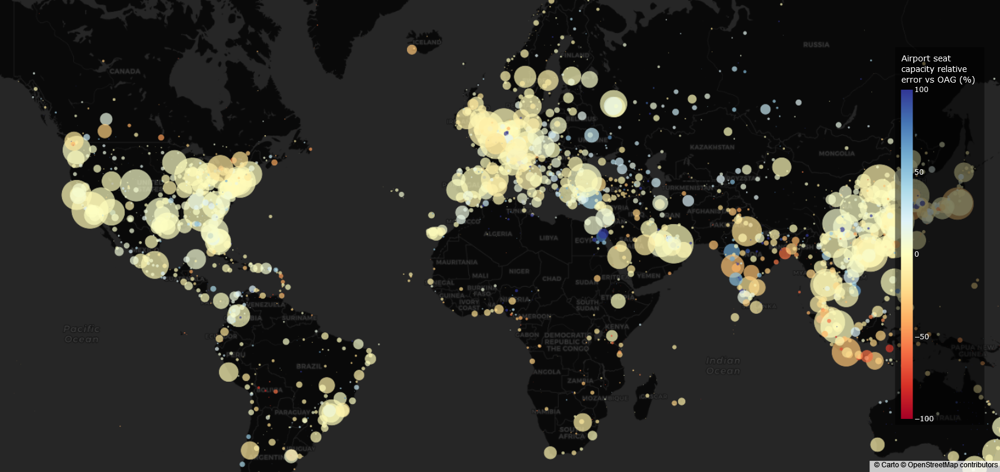

In [26]:
import geopandas as gpd
import plotly.express as px



gdf = gpd.GeoDataFrame(airport_df.reset_index(), geometry=gpd.points_from_xy(airport_df['lon'], airport_df['lat']))


# Plot the scatter plot using Plotly
fig = px.scatter_mapbox(
    gdf,
    lat="lat",
    lon="lon",
    hover_data=["IATA", gdf.seats_tot_est/1000, gdf.seats_tot_oag/1000, "change_seats"],
    color="change_seats",
    color_continuous_scale='RdYlBu',
    range_color=[-100,100],
    size="seats_tot_est",
    size_max=50,
    zoom=2,
    height=800
)

fig.update_traces(hovertemplate='Airport: %{customdata[0]} <br> Seats est (k) : %{customdata[1]:.2f}<br>Seats OAG (k): %{customdata[2]:.2f}<br>Change: %{customdata[3]:.2f}%')
fig.update_layout(mapbox_style="carto-darkmatter")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})



fig.update_layout(
    coloraxis_colorbar=dict(x=0.94, y=0.5, xanchor='center',
                            len=0.8, bgcolor='rgba(0, 0, 0, 0.5)',
                            thickness=20, tickfont=dict(color='white'),
                            title='Airport seat<br>capacity relative<br>error vs OAG (%)', title_font=dict(color='white'))
)



The plot above display the relative seat capacity estimation error of the open-source dataset compared to the OAG dataset. Negative values meansseats are missing whimle positive values means extra seats are found. The larger the circle, the bigger the airport. As it can be seen, most major airports are light yellow, meaning their traffic is reasonably well computed. 
In two countries, India and Indonesia, major airport traffic is underestimated. it could be linked to two combined phenomenons: there is a large domestic traffic in these country meaning estimation is used a lot, and they are less developped than most countries covered by the training dataset (in which Europe and USA are over-representated, hence a bias). the estimator might exagerate the influence of lower wealth.  

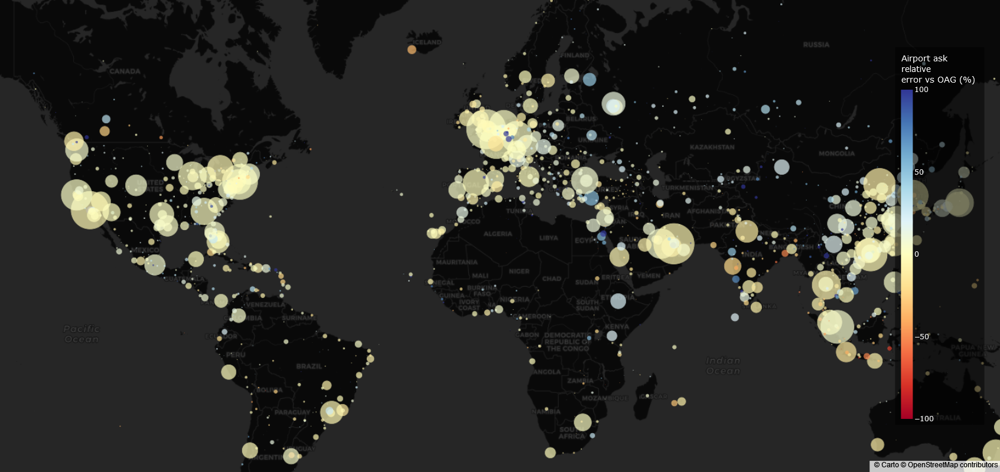

In [27]:

fig = px.scatter_mapbox(
    gdf,
    lat="lat",
    lon="lon",
    hover_data=["IATA", gdf.ask_tot_est/1000000, gdf.ask_tot_oag/1000000, "change_ask"],
    color="change_ask",
    color_continuous_scale='rdylbu',
    range_color=[-100,100],
    size="ask_tot_est",
    size_max=50,
    zoom=2,
    height=800
)

fig.update_traces(hovertemplate='Airport: %{customdata[0]} <br> ASK est (Mn): %{customdata[1]:.2f}<br>ASK OAG (Mn): %{customdata[2]:.2f}<br>Change: %{customdata[3]:.2f}%')


fig.update_layout(mapbox_style="carto-darkmatter")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

fig.update_layout(
    coloraxis_colorbar=dict(x=0.94, y=0.5, xanchor='center',
                            len=0.8, bgcolor='rgba(0, 0, 0, 0.5)',
                            thickness=20, tickfont=dict(color='white'),
                            title='Airport ask<br>relative<br>error vs OAG (%)', title_font=dict(color='white'))
)


Let's do the same at the country level

In [28]:
final_dataset_TEST_cnty=final_dataset_TEST.copy()

# A mapping of various dependencies is made: overseas territories for instance ar counted as part of the continental territory, meaning flight between these two are classified as domestic.
dependency_mapping = {
    'GP': 'FR',  # Guadeloupe -> France
    'MQ': 'FR',  # Martinique -> France
    'RE': 'FR',  # Réunion -> France
    'GF': 'FR',  # Guyane -> France
    'YT': 'FR',  # Mayotte -> France
    'WF': 'FR',  # Wallis & Futuna -> France
    'PF': 'FR',  # Polynésie -> France
    'PM': 'FR',  # St Pierre Et Miquelon -> France
    'BL': 'FR',  # St Barthélémy -> France
    'PF': 'FR',  # French Polynesia
    'WF': 'FR',  # France Wallis et Futuna
    'NC': 'FR',  # Nouvelle Calédonie
    'EH': 'MA',  # Western Sahara -> Morocco
    'JE': 'GB',  # Jersey -> UK
    'NF': 'AU',  # Norfolk Island -> Australia
    'CX': 'AU',  # Christmas Island -> Australia
    'CC': 'AU',  # Cocos Island -> Australia
    'AS': 'US',  # American Samoa -> United States
    'GU': 'US',  # Guam -> United States
    'UM-86': 'US',  # Johnston Island -> United States
    'UM-89': 'US',  # Kingman's Reef -> United States
    'UM-71': 'US',  # Midway -> United States
    'UM-95': 'US',  # Palmyra -> United States
    'PR': 'US',  # Puerto Rico -> United States
    'MP': 'US',  # Saipan (Mariana Islands) -> United States
    'VI': 'US',  # U.S. Virgin Islands -> United States
    'WK': 'US',  # Wake Island -> United States
    'HK': 'CN',  # Hong Kong SAR -> China
    'MO': 'CN',  # Macau SAR -> China
    'AI': 'GB',  # Anguilla -> United Kingdom
    'BM': 'GB',  # Bermuda -> United Kingdom
    'VG': 'GB',  # British Virgin Islands -> United Kingdom
    'KY': 'GB',  # Cayman Islands -> United Kingdom
    'FK': 'GB',  # Falkland Islands (Malvinas) -> United Kingdom
    'GI': 'GB',  # Gibraltar -> United Kingdom
    'GG': 'GB',  # Guernsey -> United Kingdom
    'IM': 'GB',  # Isle of Man -> United Kingdom
    'MS': 'GB',  # Montserrat -> United Kingdom
    'SH': 'GB',  # St. Helena and Ascension -> United Kingdom
    'TC': 'GB',  # Turks and Caicos Islands -> United Kingdom
    'AW': 'NL',  # Aruba -> Netherlands
    'BQ': 'NL',  # Bonaire -> Netherlands
    'CW': 'NL',  # Curacao -> Netherlands
    'SX': 'NL',  # Sint Maarten -> Netherlands
    'NU': 'NZ',  # Niue Islands -> New Zealand
    'FO': 'DK',  # Faroe Islands -> Denmark
    'GL': 'DK'  # Greenland -> Denmark
}

# Replace dependency ISO 2-letter codes with country ISO 2-letter codes
final_dataset_TEST_cnty['departure_country'] = final_dataset_TEST_cnty.apply(lambda row: dependency_mapping[row['departure_country']] if row['departure_country'] in dependency_mapping else row['departure_country'], axis=1)
final_dataset_TEST_cnty['arrival_country'] = final_dataset_TEST_cnty.apply(lambda row: dependency_mapping[row['arrival_country']] if row['arrival_country'] in dependency_mapping else row['arrival_country'], axis=1)

final_dataset_TEST_cnty['seats'] = final_dataset_TEST_cnty.apply(lambda row: row['seats'] if row['departure_country'] != row['arrival_country'] else 0.5*row['seats'], axis=1)
final_dataset_TEST_cnty['int_ask'] = final_dataset_TEST_cnty.apply(lambda row: row['ask'] if row['departure_country'] != row['arrival_country'] else 0, axis=1)
final_dataset_TEST_cnty['dom_ask'] = final_dataset_TEST_cnty.apply(lambda row: row['ask'] if row['departure_country'] == row['arrival_country'] else 0, axis=1)
final_dataset_TEST_cnty['int_co2'] = final_dataset_TEST_cnty.apply(lambda row: row['co2'] if row['departure_country'] != row['arrival_country'] else 0, axis=1)
final_dataset_TEST_cnty['dom_co2'] = final_dataset_TEST_cnty.apply(lambda row: row['co2'] if row['departure_country'] == row['arrival_country'] else 0, axis=1)



###

### This work 
est_seats_dep=final_dataset_TEST_cnty.groupby(['departure_country'])[['seats','ask','int_ask','dom_ask','co2','dom_co2','int_co2']].sum()
est_seats_arr=final_dataset_TEST_cnty.groupby(['arrival_country'])[['seats']].sum()
est_seats_df=est_seats_arr.reset_index().merge(est_seats_dep.reset_index(),left_on='arrival_country', right_on='departure_country', how='outer')
est_seats_df['country']=est_seats_df['arrival_country'].fillna(est_seats_df['departure_country'])
est_seats_df['seats_tot']=est_seats_df['seats_x'].fillna(0)+est_seats_df['seats_y'].fillna(0)
est_seats_df['ask_tot']=est_seats_df['ask'].fillna(0)
est_seats_df['co2_tot_est']=est_seats_df['co2'].fillna(0)
est_seats_df['int_ask']=est_seats_df['int_ask'].fillna(0)
est_seats_df['dom_ask']=est_seats_df['dom_ask'].fillna(0)
est_seats_df['int_co2_est']=est_seats_df['int_co2'].fillna(0)
est_seats_df['dom_co2_est']=est_seats_df['dom_co2'].fillna(0)


est_seats_df.drop(columns={'departure_country','arrival_country','seats_x','seats_y','ask'}, inplace=True)
est_seats_df.set_index('country', inplace=True)

est_seats_df

### OAG 2018

oag_cnty=oag.copy()

oag_cnty['ISO_country_dep'] = oag_cnty.apply(lambda row: dependency_mapping[row['ISO_country_dep']] if row['ISO_country_dep'] in dependency_mapping else row['ISO_country_dep'], axis=1)
oag_cnty['ISO_country_arr'] = oag_cnty.apply(lambda row: dependency_mapping[row['ISO_country_arr']] if row['ISO_country_arr'] in dependency_mapping else row['ISO_country_arr'], axis=1)


oag_cnty['TotalSeatCapacity'] = oag_cnty.apply(lambda row: row['TotalSeatCapacity'] if row['ISO_country_dep'] != row['ISO_country_arr'] else 0.5*row['TotalSeatCapacity'], axis=1)
oag_cnty['int_ask'] = oag_cnty.apply(lambda row: row['ask'] if row['ISO_country_dep'] != row['ISO_country_arr'] else 0, axis=1)
oag_cnty['dom_ask'] = oag_cnty.apply(lambda row: row['ask'] if row['ISO_country_dep'] == row['ISO_country_arr'] else 0, axis=1)


oag_seats_dep=oag_cnty.groupby('ISO_country_dep')[['TotalSeatCapacity','ask','int_ask','dom_ask']].sum()
oag_seats_arr=oag_cnty.groupby('ISO_country_arr')[['TotalSeatCapacity']].sum()
oag_seats_df=oag_seats_arr.reset_index().merge(oag_seats_dep.reset_index(),left_on='ISO_country_arr', right_on='ISO_country_dep', how='outer')
oag_seats_df['country']=oag_seats_df['ISO_country_arr'].fillna(oag_seats_df['ISO_country_dep'])
oag_seats_df['seats_tot']=oag_seats_df['TotalSeatCapacity_x'].fillna(0)+oag_seats_df['TotalSeatCapacity_y'].fillna(0)
oag_seats_df['ask_tot']=oag_seats_df['ask'].fillna(0)
oag_seats_df['int_ask']=oag_seats_df['int_ask'].fillna(0)
oag_seats_df['dom_ask']=oag_seats_df['dom_ask'].fillna(0)

oag_seats_df.drop(columns={'ISO_country_dep','ISO_country_arr','TotalSeatCapacity_x','TotalSeatCapacity_y','ask'}, inplace=True)
oag_seats_df.set_index('country', inplace=True)

country_df=est_seats_df.merge(oag_seats_df, left_index=True, right_index=True, how='outer', suffixes=('_est','_oag'))
country_df['change_seats']=(country_df['seats_tot_est']-country_df['seats_tot_oag'])/country_df['seats_tot_oag']*100
country_df['change_ask']=(country_df['ask_tot_est']-country_df['ask_tot_oag'])/country_df['ask_tot_oag']*100
country_df

,int_ask_est,dom_ask_est,co2,dom_co2,int_co2,seats_tot_est,ask_tot_est,co2_tot_est,int_co2_est,dom_co2_est,int_ask_oag,dom_ask_oag,seats_tot_oag,ask_tot_oag,change_seats,change_ask
country,,,,,,,,,,,,,,,,
AE,3.088751e+11,2.292462e+06,2.452880e+10,2.246071e+06,2.452656e+10,1.574508e+08,3.088774e+11,2.452880e+10,2.452656e+10,2.246071e+06,3.230748e+11,2.168280e+07,1.627185e+08,3.230964e+11,-3.237318,-4.400868
AF,2.621234e+09,1.838747e+07,2.053696e+08,2.239731e+06,2.031299e+08,2.518062e+06,2.639622e+09,2.053696e+08,2.031299e+08,2.239731e+06,1.998540e+09,4.790328e+08,3.082740e+06,2.477573e+09,-18.317410,6.540631
AG,1.747643e+09,1.672053e+06,1.388815e+08,1.015596e+06,1.378659e+08,1.365844e+06,1.749315e+09,1.388815e+08,1.378659e+08,1.015596e+06,1.733487e+09,0.000000e+00,1.488036e+06,1.733487e+09,-8.211601,0.913068
AL,2.042768e+09,0.000000e+00,1.713666e+08,0.000000e+00,1.713666e+08,4.407224e+06,2.042768e+09,1.713666e+08,1.713666e+08,0.000000e+00,1.604276e+09,0.000000e+00,3.595928e+06,1.604276e+09,22.561504,27.332720
AM,3.429540e+09,0.000000e+00,2.448192e+08,0.000000e+00,2.448192e+08,4.036457e+06,3.429540e+09,2.448192e+08,2.448192e+08,0.000000e+00,3.228653e+09,0.000000e+00,3.801849e+06,3.228653e+09,6.170884,6.222009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XK,1.424820e+09,0.000000e+00,1.082379e+08,0.000000e+00,1.082379e+08,2.571018e+06,1.424820e+09,1.082379e+08,1.082379e+08,0.000000e+00,1.213331e+09,0.000000e+00,2.181192e+06,1.213331e+09,17.872161,17.430472
YE,3.670268e+06,1.863636e+07,2.488552e+06,2.087797e+06,4.007551e+05,4.763764e+04,2.230663e+07,2.488552e+06,4.007551e+05,2.087797e+06,3.634296e+07,2.056626e+05,4.924839e+04,3.654862e+07,-3.270647,-38.967249
ZA,5.293284e+10,1.684330e+10,5.834173e+09,1.497028e+09,4.337144e+09,3.715658e+07,6.977614e+10,5.834173e+09,4.337144e+09,1.497028e+09,4.953644e+10,1.964564e+10,4.024140e+07,6.918208e+10,-7.665793,0.858693


In [29]:
country_3=pd.read_csv('data/country_codes.csv', keep_default_na=False, na_values=['','NaN'])[['Two_Letter_Country_Code','Three_Letter_Country_Code']]

In [30]:
country_df=country_df.merge(country_3, left_index=True, right_on='Two_Letter_Country_Code')

In [31]:
import geopandas as gpd
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Join the data frame with the shapefile
gdf = world.merge(country_df, left_on='iso_a3', right_on='Three_Letter_Country_Code')
gdf.head()


,pop_est,continent,name,iso_a3,gdp_md_est,geometry,int_ask_est,dom_ask_est,co2,dom_co2,...,int_co2_est,dom_co2_est,int_ask_oag,dom_ask_oag,seats_tot_oag,ask_tot_oag,change_seats,change_ask,Two_Letter_Country_Code,Three_Letter_Country_Code
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",5.269560e+09,1.335332e+08,4.161032e+08,2.121626e+07,...,3.948869e+08,2.121626e+07,5.439369e+09,9.145150e+07,3.375489e+06,5.530821e+09,-5.082656,-2.309367,FJ,FJI
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",5.480313e+09,7.899499e+08,5.033715e+08,9.350367e+07,...,4.098678e+08,9.350367e+07,5.588311e+09,1.280115e+09,8.090269e+06,6.868427e+09,-30.258921,-8.708892,TZ,TZA
2,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",1.687410e+11,7.039489e+10,1.876480e+10,5.613663e+09,...,1.315114e+10,5.613663e+09,1.711406e+11,7.824391e+10,1.522722e+08,2.493845e+11,-14.449013,-4.109568,CA,CAN
3,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",8.526323e+11,1.462218e+12,1.877142e+11,1.177835e+11,...,6.993076e+10,1.177835e+11,8.190092e+11,1.431306e+12,1.309672e+09,2.250315e+12,1.195368,2.867808,US,USA
4,18513930.0,Asia,Kazakhstan,KAZ,181665,"POLYGON ((87.35997 49.21498, 86.59878 48.54918...",1.160426e+10,6.631191e+09,1.407627e+09,5.603553e+08,...,8.472720e+08,5.603553e+08,9.990012e+09,6.784936e+09,1.360174e+07,1.677495e+10,5.179101,8.706471,KZ,KAZ


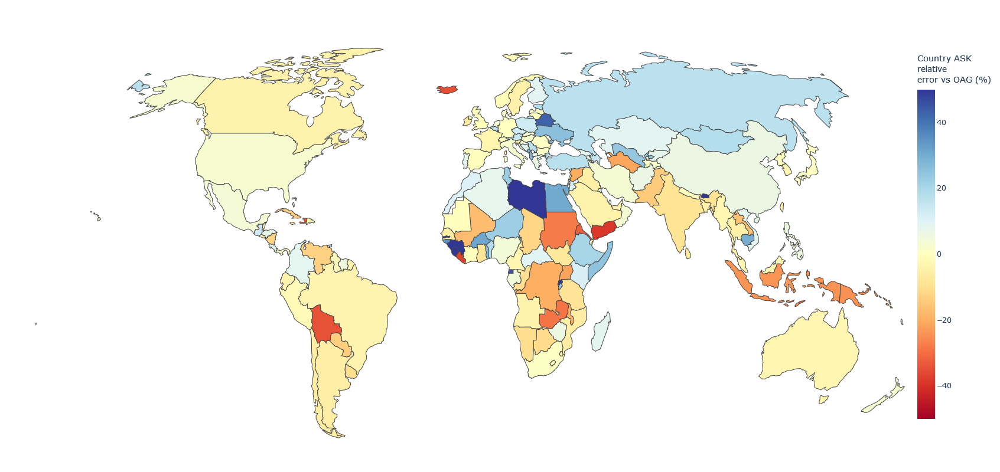

In [32]:
###ASK 

fig = px.choropleth(
    gdf,
    geojson=gdf.geometry,
    locations=gdf.index,
    color_continuous_scale='rdylbu',
    hover_data=[gdf.name,gdf.ask_tot_est/1000000000, gdf.ask_tot_oag/1000000000, "change_ask"],
    range_color=[-50,50],
    color='change_ask',
    projection="natural earth",
    height=800
)


fig.update_traces(hovertemplate='Country: %{customdata[0]}<br>ASK est (Bn): %{customdata[1]:.2f}<br>ASK OAG (Bn): %{customdata[2]:.2f}<br>Change: %{customdata[3]:.2f}%')


### SEAT CAPACITY
# fig = px.choropleth(
#     gdf,
#     geojson=gdf.geometry,
#     locations=gdf.index,
#     color_continuous_scale='rdylbu',
#     hover_data=[gdf.name,gdf.seats_tot_est/1000000, gdf.seats_tot_oag/1000000, "change_seats"],
#     range_color=[-50,50],
#     color='change_seats',
#     projection="natural earth",
#     height=800
# )


# fig.update_traces(hovertemplate='Country: %{customdata[0]} <br> Seats est (M): %{customdata[1]:.2f}<br>Seats OAG (M): %{customdata[2]:.2f}<br>Change: %{customdata[3]:.2f}%')


fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  coloraxis_colorbar=dict(
                 title='Country ASK<br>relative<br>error vs OAG (%)',
                 len=0.8, x=0.94)
                 )
fig.show()

fig.write_image("countries_ask.pdf", width=1600)

The open-source dataset quality is varioable as we can see above. However, this map does not allows to visualize each country traffic volume.  
Indeed most poorly estimated countries are very small. (_An alternative way to visualize this is to use treemaps as for the first flot of this graph. A combinaison of both is possible by ponderating countries size by the dependant varibale, but no easy way to do this was found with our graph libraries. It could be a nice way to improve this representataion._)

Nevertheless, most european, north american and eastern asian countries are well accounted for. There is an overestimation in some eastern european countries, while they are normally well covered by eurocontrol dtaa. It could be an error on OAG side, and the same holds true for turkey. Th most disapointing countries is Indonesia, with 30% of the traffic missing. 

Now, let's look at continental flows:

In [33]:
final_dataset_TEST_flow=final_dataset_TEST.copy()
final_dataset_TEST_flow['group_col'] = final_dataset_TEST_flow[['departure_continent', 'arrival_continent']].apply(lambda x: tuple(sorted(x.astype('str'))), axis=1)

In [34]:
flows=final_dataset_TEST_flow.groupby('group_col')[['seats','ask']].sum().reset_index()

In [35]:
oag_flow=oag.copy()
oag_flow['group_col'] = oag_flow[['ISO_continent_dep', 'ISO_continent_arr']].apply(lambda x: tuple(sorted(x.astype('str'))), axis=1)
flows=flows.merge(oag_flow.groupby('group_col')[['TotalSeatCapacity','ask']].sum().reset_index().rename(columns={'ask':'oag_ask'}), on='group_col', how='left')

In [36]:
flows['change_seats']=(flows['seats']-flows['TotalSeatCapacity'])/flows['TotalSeatCapacity']*100
flows['change_ask']=(flows['ask']-flows['oag_ask'])/flows['oag_ask']*100

In [37]:
flows = flows[flows['ask']!=0]

In [38]:
flows.sort_values(by='ask', ascending=False)

,group_col,seats,ask,TotalSeatCapacity,oag_ask,change_seats,change_ask
6,"(AS, AS)",1.958764e+09,2.826824e+12,2.132808e+09,2.860450e+12,-8.160338,-1.175551
17,"(NA, NA)",1.258702e+09,1.811640e+12,1.272727e+09,1.790216e+12,-1.101975,1.196731
12,"(EU, EU)",1.127121e+09,1.239874e+12,1.164644e+09,1.230046e+12,-3.221831,0.798991
7,"(AS, EU)",2.571502e+08,1.215498e+12,2.403096e+08,1.132229e+12,7.007873,7.354444
13,"(EU, NA)",1.329876e+08,9.381215e+11,1.309194e+08,9.053014e+11,1.579774,3.625322
8,"(AS, NA)",5.801415e+07,6.288137e+11,5.655516e+07,6.065660e+11,2.579756,3.667806
2,"(AF, EU)",1.275583e+08,4.020689e+11,1.132391e+08,3.626149e+11,12.645024,10.880391
9,"(AS, OC)",4.998632e+07,3.520951e+11,5.421590e+07,3.762785e+11,-7.801374,-6.426980
24,"(SA, SA)",2.356474e+08,2.362855e+11,2.513937e+08,2.522415e+11,-6.263594,-6.325709
18,"(NA, OC)",2.857554e+07,1.794748e+11,2.624652e+07,1.597776e+11,8.873629,12.327916


The same table is rendered as a pivot table below

In [39]:
flows_cop=flows.copy()

flows_cop[['continent_1', 'continent_2']] = pd.DataFrame(flows_cop['group_col'].tolist(), index=flows_cop.index)

flows_cop['ASK (Bn)'] = flows_cop.apply(lambda row: f"{int(row['ask']/1e9):,} ({row['change_ask']:.1f}%)", axis=1)

# Create the pivot table using 'col1' and 'col2' as the index and 'ask' and 'change_ask' as values
pivot_table = flows_cop.pivot(index='continent_2', columns='continent_1', values=['ASK (Bn)'])

In [40]:
pivot_table.fillna

<bound method DataFrame.fillna of                 ASK (Bn)                                             \
continent_1           AF             AS            EU            NA   
continent_2                                                           
AF            99 (-8.0%)            NaN           NaN           NaN   
AS            165 (5.4%)  2,826 (-1.2%)           NaN           NaN   
EU           402 (10.9%)   1,215 (7.4%)  1,239 (0.8%)           NaN   
NA            34 (44.7%)     628 (3.7%)    938 (3.6%)  1,811 (1.2%)   
OC             4 (-5.5%)    352 (-6.4%)   14 (627.2%)   179 (12.3%)   
SA             8 (19.2%)     15 (38.9%)    178 (4.6%)   157 (-6.6%)   

                                       
continent_1           OC           SA  
continent_2                            
AF                   NaN          NaN  
AS                   NaN          NaN  
EU                   NaN          NaN  
NA                   NaN          NaN  
OC           148 (-5.2%)          NaN  
SA    

Finally, a treemap plot is given below. Top 15 largest flows are  all within 12\% of OAG reference, with much better results in most of the cases. Minor flows are less accurate and especially Europe/Oceania. To determine which source creates errors, an investigation procedure is implemented afterwards.

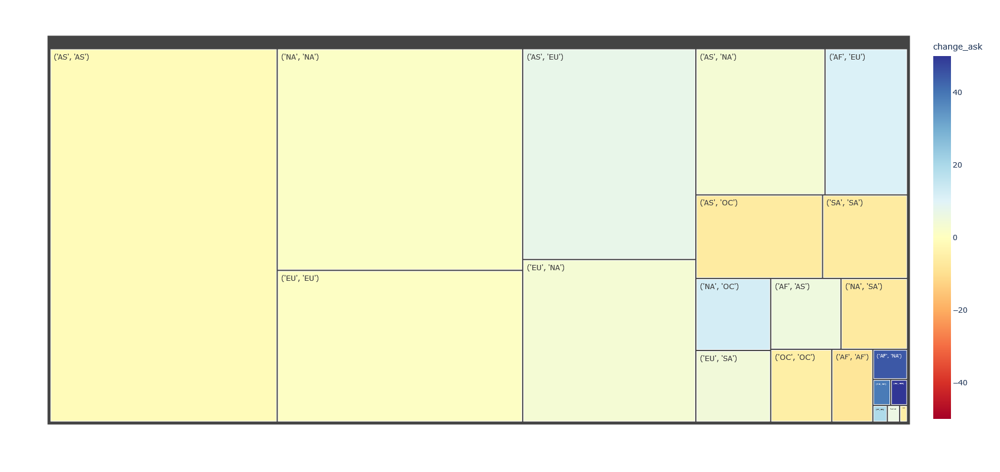

In [41]:
px.treemap(flows, 
           path=['group_col'], 
           values='ask',
           color='change_ask',
           color_continuous_scale='RdYLBu',
           
           range_color=[-50,50],
          height=800)

Investigation: first an airport-level dataset containing both our and OAG data, with country and continent informations is recreated (using outer merge)

In [42]:
# final_dataset_TEST['group_col'] = final_dataset_TEST[['iata_departure', 'iata_arrival']].apply(lambda x: tuple(sorted(x)), axis=1)

est_grouped=final_dataset_TEST.groupby(['iata_departure','iata_arrival','source'])[['seats','ask']].sum().reset_index()


# est_df_oag=est_grouped.merge(oag_grouped, on='group_col', how='outer')
oag_select=oag[['DepAirport',
'ArrAirport',
'TotalSeatCapacity']].rename(columns={'DepAirport':'iata_departure','ArrAirport':'iata_arrival'}).drop_duplicates()

oag_select=oag_select.groupby(['iata_departure','iata_arrival'])['TotalSeatCapacity'].sum().reset_index()


est_grouped=est_grouped.merge(oag_select.dropna(subset={'iata_departure','iata_arrival'}), on=['iata_departure','iata_arrival'], how='outer')

In [43]:
est_grouped.seats.sum()

5570264647.798286

In [76]:
airport_db_prod=pd.read_csv('../02_airport_features/data/airports.csv', sep=';',keep_default_na=False, na_values=['','NaN'])[['iata_code','iso_country', 'continent']]

In [77]:
est_grouped=est_grouped.merge(airport_db_prod.dropna(subset='iata_code').add_suffix('_departure'), left_on='iata_departure', right_on='iata_code_departure', how='left', suffixes=('','_departure'))
est_grouped=est_grouped.merge(airport_db_prod.dropna(subset='iata_code').add_suffix('_arrival'), left_on='iata_arrival', right_on='iata_code_arrival', how='left', suffixes=('','_arrival'))

# est_grouped
est_grouped['continent_arrival']=est_grouped.apply(lambda row: 'EU' if row['iso_country_arrival']=='TR' else row['continent_arrival'], axis=1)
est_grouped['continent_departure']=est_grouped.apply(lambda row: 'EU' if row['iso_country_departure']=='TR' else  row['continent_departure'], axis=1)

Proper filtering section:
- data is filtered at the country pair on continent pair level.
- when the route is in the source and in teh reference (OAG), a 'delta' in terms of seat capacity is computed 
- when teh route is not present in OAG, an 'extra' term is computed
- same for the routes in the ref but not in our sources 

In [93]:
ct1='EU'
ct2='OC'

## World: 
est_gp_filt=est_grouped.copy()

## Country pair

# est_gp_filt=est_grouped.query('(`iso_country_departure`==@ct1) | (`iso_country_arrival`==@ct1) ')

## Continent pair
# est_gp_filt=est_grouped.query('(`continent_departure`==@ct1 & `continent_arrival`==@ct2) | (`continent_departure`==@ct2 & `continent_arrival`==@ct1) ')

gpd_flow=est_gp_filt.groupby(['source'])[['seats','TotalSeatCapacity']].sum()
gpd_flow_delta_source=est_gp_filt[~est_gp_filt.TotalSeatCapacity.isna()].groupby(['source'])['TotalSeatCapacity'].sum()-est_gp_filt[~est_gp_filt.TotalSeatCapacity.isna()].groupby(['source'])['seats'].sum()
gpd_flow_extra_source=est_gp_filt[est_gp_filt.TotalSeatCapacity.isna()].groupby(['source'])[['seats']].sum()
gpd_flow_extra_oag=est_gp_filt[est_gp_filt.seats.isna()]['TotalSeatCapacity'].sum()

In [94]:
gpd_flow['delta_ref']=gpd_flow_delta_source

gpd_flow['extra_ref']=-gpd_flow_extra_source

In [95]:
gpd_flow.sum()

seats                5.570265e+09
TotalSeatCapacity    5.677145e+09
delta_ref            3.874070e+08
extra_ref           -2.805263e+08
dtype: float64

In [96]:
gpd_flow_extra_oag

122016458.608

In [97]:
# Calculate the percentages
gpd_percentage = (gpd_flow / gpd_flow.sum()) * 100

gpd_percentage.drop(columns={'TotalSeatCapacity'})

,seats,delta_ref,extra_ref
source,,,
ANAC,2.382726,1.717291,0.505647
AUS Stats,1.239014,0.789992,0.183967
BTS,23.247828,6.181499,5.247808
Estimation,29.763296,40.907227,60.952879
Eurocontrol,24.157706,11.767444,13.746722
OpenSky,3.720576,34.370172,8.515559
WorldBank,15.488855,4.266375,10.847417


Ideally, 'seats and 'TotalSeatCapacity' would be close and both 'delta ref' and 'extra ref' an order a magnitude lower.

The steps below are made to display this with a cascade plot.

In [98]:
vals=gpd_flow.seats.to_list()+gpd_flow.delta_ref.to_list()+gpd_flow.extra_ref.to_list()

In [99]:
vals.append(gpd_flow_extra_oag)
vals.append(-est_gp_filt.TotalSeatCapacity.sum())

In [100]:
labels=[sub+'_tot' for sub in gpd_flow.index.to_list()]+[sub+'_delta' for sub in gpd_flow.index.to_list()]+[sub+'_extra' for sub in gpd_flow.index.to_list()]
labels.append('OAG_extra')
labels.append('OAG_tot')

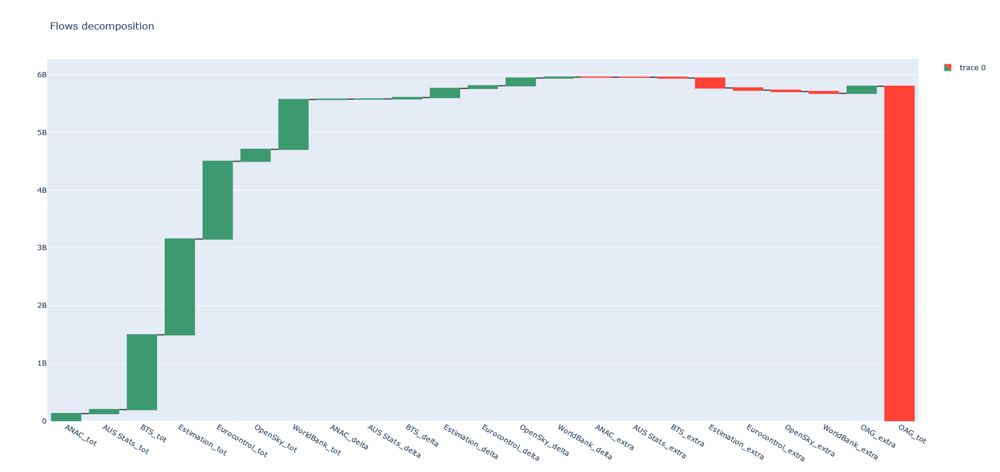

In [101]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.colors 



fig = go.Figure(go.Waterfall(

    measure = ["relative", "relative", "relative", "relative",'relative',"relative", "relative", "relative", "relative",'relative',"relative", "relative",'relative','relative'],
    x = labels,
    textposition = "outside",
    y = vals,
    connector = {"line":{"color":"rgb(63, 63, 63)"}},
    
))

fig.update_layout(
        title = "Flows decomposition",
        showlegend = True, 
    height=800
)

fig.show()

In [92]:
est_gp_filt.groupby('source')['seats'].sum()

source
BTS                44.000000
Eurocontrol      1506.657025
OpenSky        460809.375268
WorldBank      420595.644000
Name: seats, dtype: float64

## GACA (ICCT)

GACA assumes a departure country allocation for ask and CO2 emisisons.  

In [56]:
country_df=country_df.merge(country_code[['Two_Letter_Country_Code','Continent_Code']], on='Two_Letter_Country_Code')

In [57]:
gaca=pd.read_csv('data/gaca_reference.csv', sep=';').dropna(subset='ISO')
# Taking into account average LF to convert RPK in ASK
gaca[['Intl brpk', 'Dom brpk', 'Tot brpk']]=gaca[['Intl brpk', 'Dom brpk', 'Tot brpk']].astype(float).multiply(1/0.824*1000000000)

# in ICCT doc, Belly cargo represents 8% of the flights we've considered in this estimation. Co2 values should thereofe be increased by 8.8% to compare on a fair basis.
gaca[['dom_co2_icct', 'int_co2_icct', 'co2_tot_icct']]=gaca[['dom_co2_icct', 'int_co2_icct', 'co2_tot_icct']].astype(float).multiply(1.088*1000000000)
gaca.rename(columns={'Intl brpk':'int_ask_icct', 'Dom brpk':'dom_ask_icct', 'Tot brpk':'ask_tot_icct'}, inplace=True)

merged_cnty=gaca.merge(country_df[['Two_Letter_Country_Code','int_ask_est','dom_ask_est','ask_tot_est', 'int_co2_est','dom_co2_est','co2_tot_est','Continent_Code']], left_on='ISO', right_on='Two_Letter_Country_Code', how='outer')

ROW_est_dom_ask = merged_cnty['dom_ask_est'].loc[merged_cnty['dom_ask_icct'].isnull()].sum()
ROW_est_int_ask = merged_cnty['int_ask_est'].loc[merged_cnty['int_ask_icct'].isnull()].sum()
ROW_est_tot_ask = merged_cnty['ask_tot_est'].loc[merged_cnty['ask_tot_icct'].isnull()].sum()


ROW_est_dom_co2 = merged_cnty['dom_co2_est'].loc[merged_cnty['dom_co2_icct'].isnull()].sum()
ROW_est_int_co2 = merged_cnty['int_co2_est'].loc[merged_cnty['int_co2_icct'].isnull()].sum()
ROW_est_tot_co2 = merged_cnty['co2_tot_est'].loc[merged_cnty['co2_tot_icct'].isnull()].sum()



In [58]:
merged_cnty.dropna(subset='ISO', inplace=True)



row={'Departure Country':'Rest of the World', 'ISO': np.nan, 'int_ask_icct': 215*1000000000, 'dom_ask_icct':5.58*1000000000,
       'ask_tot_icct':220.4*1000000000, 'Two_Letter_Country_Code': np.nan, 'int_ask_est':ROW_est_int_ask , 'dom_ask_est':ROW_est_dom_ask,
       'ask_tot_est':ROW_est_tot_ask,'dom_co2_est':ROW_est_dom_co2,'int_co2_est':ROW_est_int_co2,'co2_tot_est':ROW_est_tot_co2, 'int_co2_icct': 18.7*1000000000, 'dom_co2_icct':1.22*1000000000,
       'co2_tot_icct':19.9*1000000000,'Continent_Code':'ROW'}

merged_cnty=merged_cnty.append(row, ignore_index=True)

merged_cnty.drop(columns='Two_Letter_Country_Code',inplace=True)

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_5956\3057608246.py:10: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [59]:
merged_cnty['dom_error_ask']=(merged_cnty['dom_ask_est']-merged_cnty['dom_ask_icct'])/merged_cnty['dom_ask_icct']*100
merged_cnty['int_error_ask']=(merged_cnty['int_ask_est']-merged_cnty['int_ask_icct'])/merged_cnty['int_ask_icct']*100
merged_cnty['tot_error_ask']=(merged_cnty['ask_tot_est']-merged_cnty['ask_tot_icct'])/merged_cnty['ask_tot_icct']*100


merged_cnty['dom_error_co2']=(merged_cnty['dom_co2_est']-merged_cnty['dom_co2_icct'])/merged_cnty['dom_co2_icct']*100
merged_cnty['int_error_co2']=(merged_cnty['int_co2_est']-merged_cnty['int_co2_icct'])/merged_cnty['int_co2_icct']*100
merged_cnty['tot_error_co2']=(merged_cnty['co2_tot_est']-merged_cnty['co2_tot_icct'])/merged_cnty['co2_tot_icct']*100

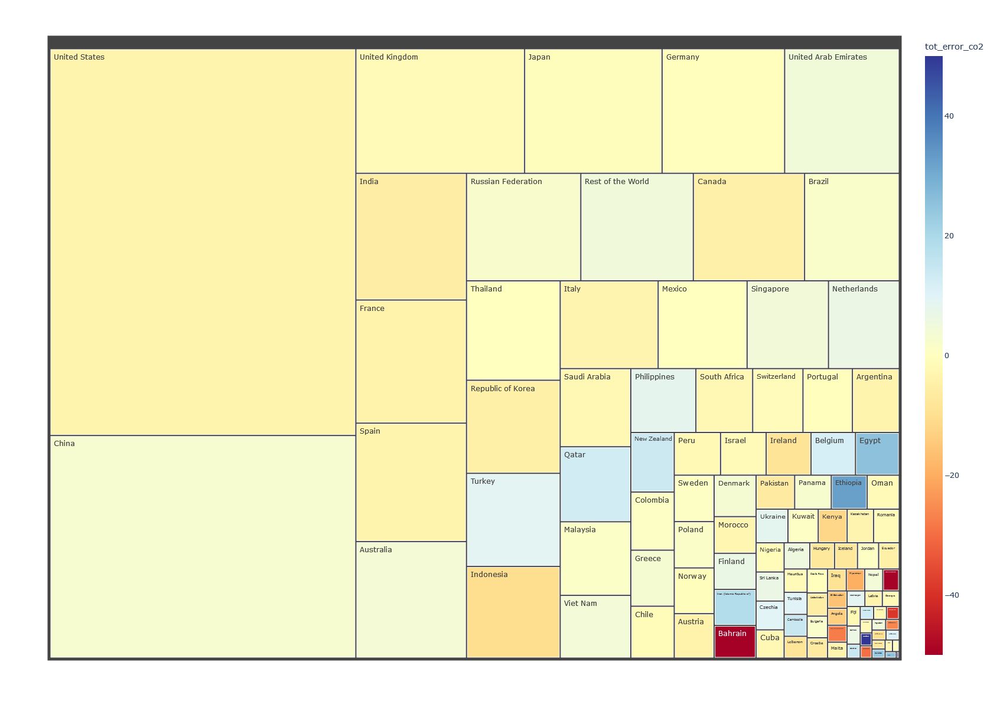

In [60]:
px.treemap(merged_cnty, 
           path=['Departure Country'], 
           values='co2_tot_icct',
           color='tot_error_co2',
           color_continuous_scale='RdYLBu',
           range_color=[-50,50],
          height=1200)

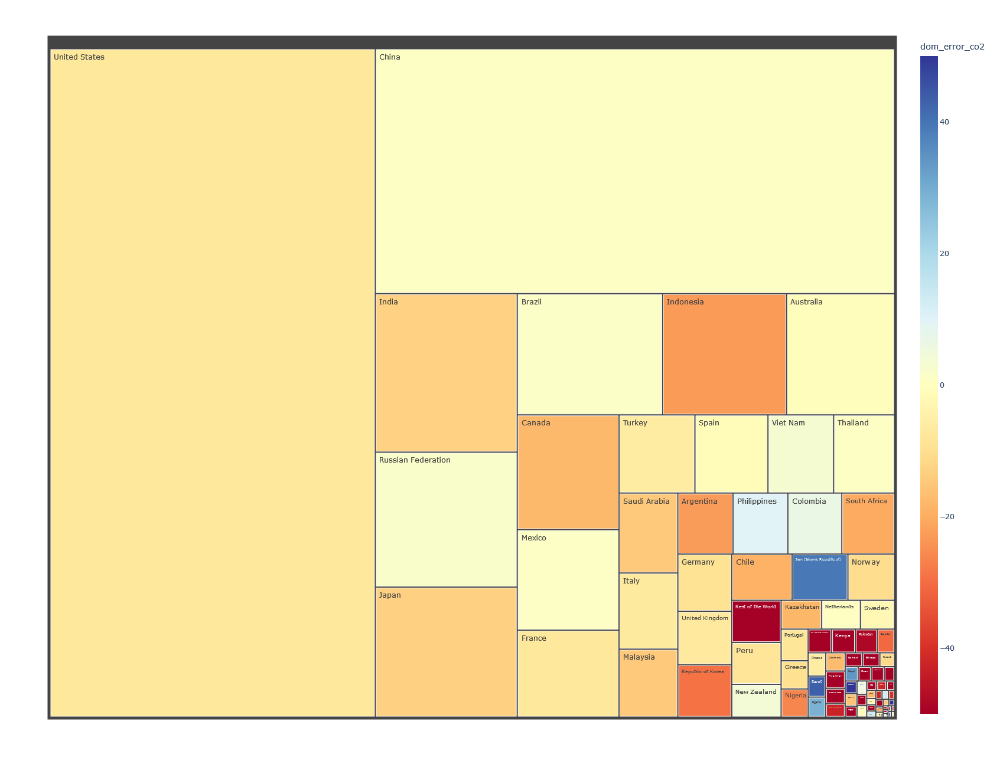

In [61]:


px.treemap(merged_cnty[merged_cnty['dom_co2_icct']>0], 
           path=['Departure Country'], 
           values='dom_co2_icct',
           color='dom_error_co2',
           color_continuous_scale='RdYLBu',
           range_color=[-50,50],
          height=1300)

In [62]:
totals_world=merged_cnty.sum()

totals_world['tot_error_co2']=(-totals_world['co2_tot_icct']+totals_world['co2_tot_est'])/totals_world['co2_tot_icct']*100  
totals_world['int_error_co2']=(-totals_world['int_co2_icct']+totals_world['int_co2_est'])/totals_world['int_co2_icct']*100 
totals_world['dom_error_co2']=(-totals_world['dom_co2_icct']+totals_world['dom_co2_est'])/totals_world['dom_co2_icct']*100 

totals_world['tot_error_ask']=(-totals_world['ask_tot_icct']+totals_world['ask_tot_est'])/totals_world['ask_tot_icct']*100  
totals_world['int_error_ask']=(-totals_world['int_ask_icct']+totals_world['int_ask_est'])/totals_world['int_ask_icct']*100 
totals_world['dom_error_ask']=(-totals_world['dom_ask_icct']+totals_world['dom_ask_est'])/totals_world['dom_ask_icct']*100 

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_5956\3697742471.py:1: FutureWarning:

The default value of numeric_only in DataFrame.sum is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



In [63]:
totals_world

Departure Country    United StatesChinaUnited KingdomJapanGermanyUn...
int_ask_icct                                      6703774271844.661133
dom_ask_icct                                      3817667378640.777832
ask_tot_icct                                     10520836893203.882812
int_co2_icct                                            521345120000.0
dom_co2_icct                                            330405280000.0
co2_tot_icct                                            851784800000.0
int_ask_est                                       6971191264434.354492
dom_ask_est                                       3693132335965.078613
ask_tot_est                                      10664323600399.431641
int_co2_est                                        539709384311.014893
dom_co2_est                                        310470116857.899231
co2_tot_est                                        850179501168.914062
Continent_Code       NAASEUASEUASASEUEUOCEUNASAASEUASEUASNAASEUASAS...
dom_er

In [64]:
totals_gpby=merged_cnty.groupby('Continent_Code').sum()
totals_gpby.loc['World',:] = totals_gpby.sum()


totals_gpby['tot_error_co2']=(-totals_gpby['co2_tot_icct']+totals_gpby['co2_tot_est'])/totals_gpby['co2_tot_icct']*100  
totals_gpby['int_error_co2']=(-totals_gpby['int_co2_icct']+totals_gpby['int_co2_est'])/totals_gpby['int_co2_icct']*100 
totals_gpby['dom_error_co2']=(-totals_gpby['dom_co2_icct']+totals_gpby['dom_co2_est'])/totals_gpby['dom_co2_icct']*100 

totals_gpby['tot_error_ask']=(-totals_gpby['ask_tot_icct']+totals_gpby['ask_tot_est'])/totals_gpby['ask_tot_icct']*100  
totals_gpby['int_error_ask']=(-totals_gpby['int_ask_icct']+totals_gpby['int_ask_est'])/totals_gpby['int_ask_icct']*100 
totals_gpby['dom_error_ask']=(-totals_gpby['dom_ask_icct']+totals_gpby['dom_ask_est'])/totals_gpby['dom_ask_icct']*100 

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_5956\1404726650.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [65]:
totals_gpby.sort_values(by='ask_tot_est', ascending=False)

,int_ask_icct,dom_ask_icct,ask_tot_icct,int_co2_icct,dom_co2_icct,co2_tot_icct,int_ask_est,dom_ask_est,ask_tot_est,int_co2_est,dom_co2_est,co2_tot_est,dom_error_ask,int_error_ask,tot_error_ask,dom_error_co2,int_error_co2,tot_error_co2
Continent_Code,,,,,,,,,,,,,,,,,,
World,6.703774e+12,3.817667e+12,1.052084e+13,5.213451e+11,3.304053e+11,8.517848e+11,6.971191e+12,3.693132e+12,1.066432e+13,5.397094e+11,3.104701e+11,8.501795e+11,-3.262072,3.989051,1.363834,-6.033549,3.522477,-0.188463
AS,2.333920e+12,1.490789e+12,3.824114e+12,1.811520e+11,1.251635e+11,3.065114e+11,2.457653e+12,1.399205e+12,3.856858e+12,1.901151e+11,1.196537e+11,3.097687e+11,-6.143296,5.301521,0.856260,-4.402121,4.947813,1.062725
NA,1.137172e+12,1.629235e+12,2.766444e+12,9.199040e+10,1.402541e+11,2.322554e+11,1.176477e+12,1.604366e+12,2.780843e+12,9.470341e+10,1.295032e+11,2.242067e+11,-1.526447,3.456362,0.520487,-7.665254,2.949236,-3.465452
EU,2.347233e+12,3.732524e+11,2.720983e+12,1.777357e+11,3.364096e+10,2.113005e+11,2.354995e+12,3.744255e+11,2.729421e+12,1.791269e+11,3.245286e+10,2.115797e+11,0.314279,0.330700,0.310101,-3.531706,0.782731,0.132159
SA,2.296723e+11,1.902913e+11,4.199150e+11,1.722304e+10,1.777792e+10,3.496832e+10,2.281705e+11,1.830560e+11,4.112265e+11,1.778833e+10,1.675612e+10,3.454445e+10,-3.802181,-0.653912,-2.069116,-5.747586,3.282161,-1.212164
OC,2.285073e+11,9.788835e+10,3.262500e+11,1.740800e+10,8.812800e+09,2.616640e+10,2.363920e+11,1.001462e+11,3.365382e+11,1.874948e+10,8.690055e+09,2.743954e+10,2.306577,3.450513,3.153464,-1.392799,7.706119,4.865540
AF,2.122694e+11,3.063107e+10,2.427306e+11,1.713600e+10,3.536000e+09,2.068288e+10,2.527400e+11,2.787673e+10,2.806167e+11,1.896424e+10,2.816416e+09,2.178065e+10,-8.991968,19.065653,15.608300,-20.350226,10.668974,5.307633
ROW,2.150000e+11,5.580000e+09,2.204000e+11,1.870000e+10,1.220000e+09,1.990000e+10,2.647633e+11,4.056570e+09,2.688198e+11,2.026199e+10,5.977483e+08,2.085974e+10,-27.301617,23.145706,21.969073,-51.004242,8.352897,4.822814
